In [1]:

import pandas as pd
pd.options.mode.chained_assignment = None  # default='warn'
import numpy as np
import plotly.express as px
from matplotlib import pyplot as plt
import plotly.graph_objects as go
from plotly.subplots import make_subplots


plt.style.use(['science', 'no-latex', 'notebook', 'grid'])

Некоторые эксперименты имеют пропуски в данных в виде тире. От них необходимо будет избавиться.

In [2]:
def delete_hyphens(frame) -> pd.DataFrame:
    """ Функция заменяет все значения в формате str в таблице на NaN, игнорируя формулы и названия

    Args:
        frame (pd.DataFrame): Таблица с данными, в которых может быть значение в формате str

    Returns:
        pd.DataFrame: Таблица с данными, где все str заменены на NaN
    """
    new_frame = pd.DataFrame()
    for column in range(len(frame.columns)):
        if frame.columns[column] == 'salts' or frame.columns[column] == 'name':
            new_frame[frame.columns[column]] = frame[frame.columns[column]]
        else:
            new_frame[frame.columns[column]] = frame[frame.columns[column]].apply(lambda x: np.nan if type(x) == str else x)
    return new_frame

    
        
    
        


Откроем базу данных экспериментов равновесия жидкость-пар для бинарной системы азотной кислоты с водой. Эксперименты проводились при разных мольных соотношениях, температурах и давлениях. Наиболее наглядным должно быть представление результатов экспериментов в трех координатах.

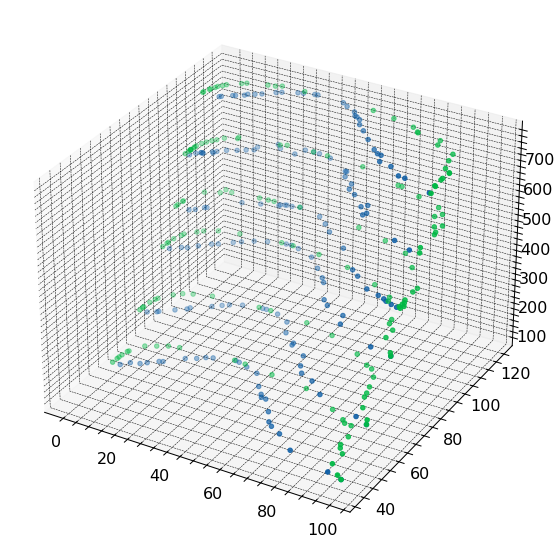

In [3]:
HNO3_H2O = pd.read_excel('l_v/HNO3-H2O_p.xlsx')
fig = plt.figure(figsize=(10,10))
axes = fig.add_subplot(projection = '3d')
axes.scatter(HNO3_H2O['x'], HNO3_H2O['t'], HNO3_H2O['p'])
axes.scatter(HNO3_H2O['y'], HNO3_H2O['t'], HNO3_H2O['p'])

Получился малоинформативный график, попробуем его улучшить. (Ниже мне удалось построить красивый 3D график этих экспериментов) Сперва познакомимся с данными и научимся их интерпретировать. Возьмем срез- серию экспериментов при давлении 600 мм.рт.ст.

Text(0.5, 0, 'Количество азотной кислоты, %')

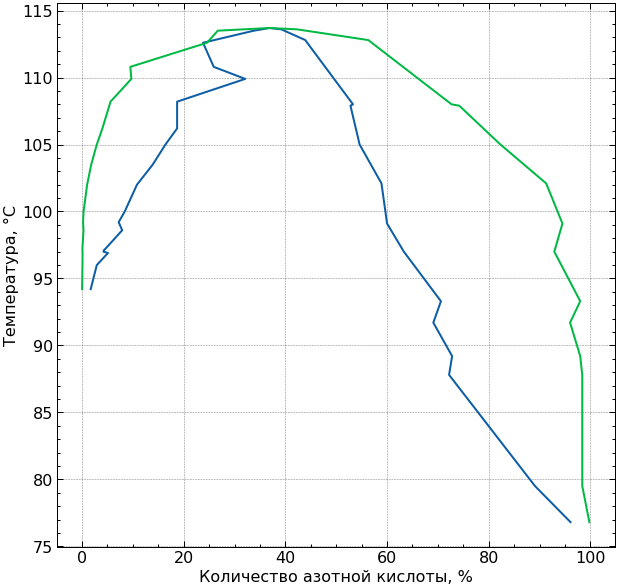

In [4]:
p600 = HNO3_H2O[HNO3_H2O['p'] == 600]
fig = plt.figure(figsize=(10,10))
axes = fig.add_subplot()
axes.plot(p600['x'], p600['t'])
axes.plot(p600['y'], p600['t'])
axes.set_ylabel('Температура, °С')
axes.set_xlabel('Количество азотной кислоты, %')



На графике зеленым цветом отображена паровая фаза, синим жидкая. Таким образом если наша смесь закипит при температуре 100°С, то в растворе у нас будет ~10% кислоты, а пар будет состоять полностью из воды. Ровно при такой же температуре закипит раствор азотной кислоты концентрацией 60%, а пар над ним на ~90% будет состоять из азотной кислоты. Если же мы смешаем воду с азотной кислотой в количестве 40%, то как видно из графика, разделить их кипячением будет невозможно. Такая точка называется азеотропом.

Кривая жидкой фазы имеет аномальную вогнутость внутрь. Напишем функцию которая сглаживает эту ошибку.

In [5]:
def delete_experiment_rerrors(frame, col) -> pd.DataFrame:
    """Функция преобразует серию данных, удаляя те точки, в которых значение аргумента \n
    уменьшается при увеличении индекса. В условиях последовательного эксперимента это ошибка.

    Args:
        frame (pd.DataFrame): Таблица со всеми данными экспериментов бинарной смеси.
        col (_type_): Серия экспериментов, по которой проводится проверка.

    Returns:
        pd.DataFrame: Таблица с данными без ошибок экспериментов.
    """
    x_ = np.arange(len(frame)).astype('float64')
    values = frame[col].values
    for i in range(len(frame)):
        if i < len(frame)-1:
            x_[i] = values[i+1] - values[i]            
        else:
            x_[i] = 0
        frame['xi'] = x_
    return frame.drop(index = frame[frame['xi'] < 0].index)

In [6]:
p600 = delete_experiment_rerrors(p600, 'x')
#p600 = delete_values(p600, 'y')
p600


,x,y,t,p,xi
24,1.7,0.01,94.2,600,1.2
25,2.9,0.08,96.0,600,2.2
27,4.2,0.07,97.0,600,0.1
28,4.3,0.08,97.1,600,0.5
29,4.8,0.08,97.3,600,3.1
31,7.2,0.20,99.2,600,1.2
32,8.4,0.30,100.0,600,2.4
33,10.8,1.00,102.0,600,3.1
34,13.9,1.80,103.5,600,2.5
35,16.4,2.90,105.0,600,2.3


Удалив данные ошибочных экспериментов построим график снова.

Text(0.5, 0, 'Количество азотной кислоты, %')

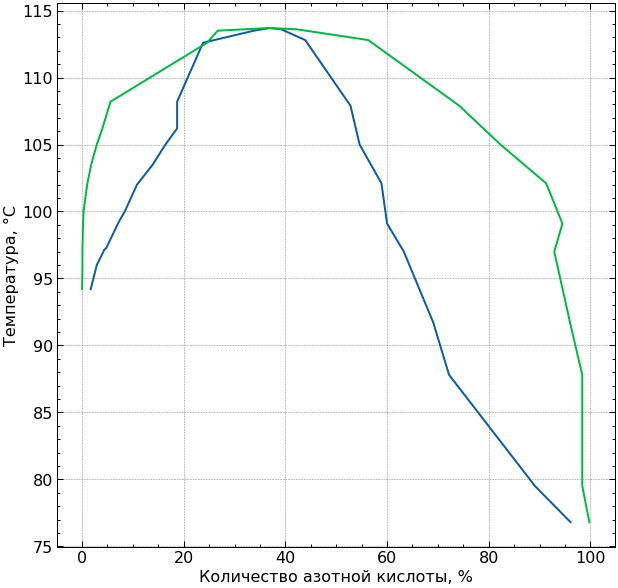

In [7]:
fig = plt.figure(figsize=(10,10))
axes = fig.add_subplot()
axes.plot(p600['x'], p600['t'])
axes.plot(p600['y'], p600['t'])
axes.set_ylabel('Температура, °С')
axes.set_xlabel('Количество азотной кислоты, %')


Заменим набор данных экспериментов на функцию, которая будет описываться некоторым произвольным полиномом, отвечающим критерию минимума среднеквадратичной ошибки.

In [8]:
def get_fit(x, y) -> np.array:
    """Функция возвращает аппроксимизированные значение
    кривой серии экспериментов полиномом 0-6 порядка

    Args:
        x (pd.Series): Значения аргумента, по которому строится полином
        y (pd.Series): Значения функции аргумента, по которому строится полином

    Returns:
        np.array: Значения полинома функции аргумента кривой серии экспериментов
    """
    rmse = []
    for i in range(7):    
        coefficient = np.polyfit(x, y, i)
        y_i = np.polyval(coefficient, x)  
        rmse.append((np.square(y - y_i )).mean())
    n_poly = rmse.index(min(np.array(rmse)))
    y_coeff = np.polyfit(x,y,n_poly)
    y_n = np.polyval(y_coeff, x)
    return y_n

Text(0.5, 0, 'Количество азотной кислоты, %')

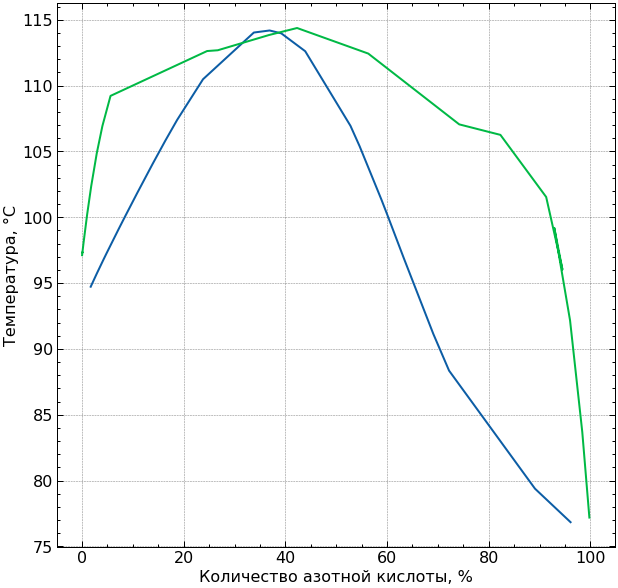

In [9]:
fig = plt.figure(figsize=(10,10))
axes = fig.add_subplot()
t_x = get_fit(p600['x'],p600['t'])
t_y = get_fit(p600['y'],p600['t'])
axes.plot(p600['x'], t_x)
axes.plot(p600['y'], t_y)
axes.set_ylabel('Температура, °С')
axes.set_xlabel('Количество азотной кислоты, %')


Функция несколько сгладилась и  мы получили инструмент с работой над данными. Теперь мы можем узнать значение функции при любом соотношении, а не только при том, в котором был эксперимент.

In [10]:
def get_coeffs(x, y) -> np.array:
    """Функция возвращает уравнение полинома, по которому можно будет найти значение
    аргумента.

    Args:
        x (pd.Series): Значения аргумента, по которому строится полином.
        y (pd.Series): Значения функции аргумента, по которому строится полином.

    Returns:
        np.array: Коэффициенты уравнения полинома.
    """
    rmse = []
    for i in range(7):    
        coefficient = np.polyfit(x, y, i)
        y_i = np.polyval(coefficient, x)  
        rmse.append((np.square(y - y_i )).mean())
    n_poly = rmse.index(min(np.array(rmse)))
    y_coeff = np.polyfit(x,y,n_poly)
    
    return y_coeff

Теперь узнаем ширину области азеотропа для смеси азотная кислота - вода при давлении 600 мм рт. ст.

In [11]:
d_x = get_coeffs(p600['x'],p600['t'])
d_y = get_coeffs(p600['y'],p600['t'])
p = np.arange(100)
for i in range(100):
    p[i] = np.poly1d(d_y)(i)- np.poly1d(d_x)(i)
ser = pd.Series(p)
list(ser[ser == 0].index)

[27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41]

Получилось что начиная с 27% до 41% смесь азотной кислоты с водой не может быть разделена ректификацией.

In [12]:
p_list = list(HNO3_H2O['p'].value_counts().index)
p_list.sort()
p_list


[100, 200, 350, 450, 600, 760]

В наших данных есть информация о нескольких давлениях, при которых изучалась смесь. Давайте изучим как себя ведет смесь при давлении 100 мм.рт.ст.

Text(0.5, 0, 'Количество азотной кислоты, %')

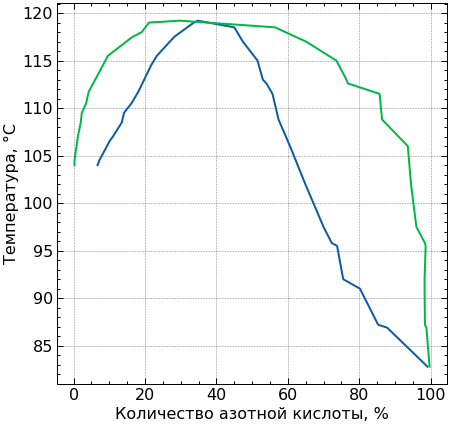

In [54]:
p100 = HNO3_H2O[HNO3_H2O['p'] == 100]
fig = plt.figure(figsize=(7,7))
axes = fig.add_subplot()
axes.plot(p100['x'], p100['t'])
axes.plot(p100['y'], p100['t'])
axes.set_ylabel('Температура, °С')
axes.set_xlabel('Количество азотной кислоты, %')


Text(0.5, 0, 'Количество азотной кислоты, %')

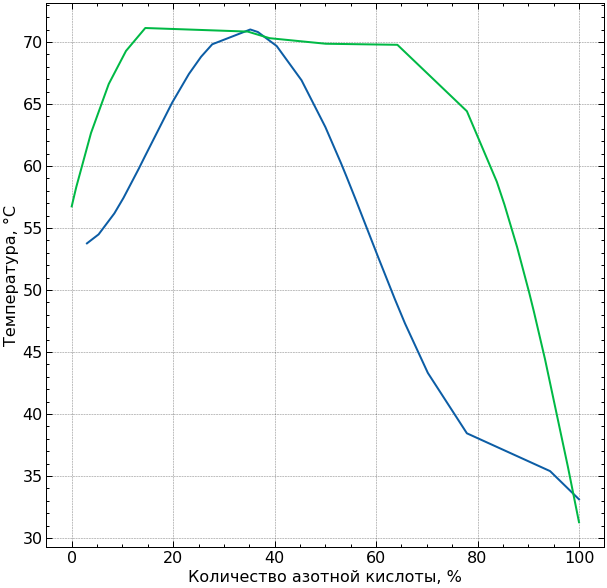

In [14]:
p100 = delete_experiment_rerrors(p100, 'x')
p100 = delete_experiment_rerrors(p100, 'y')
fig = plt.figure(figsize=(10,10))
axes = fig.add_subplot()
t_x = get_fit(p100['x'],p100['t'])
t_y = get_fit(p100['y'],p100['t'])
axes.plot(p100['x'], t_x)
axes.plot(p100['y'], t_y)
axes.set_ylabel('Температура, °С')
axes.set_xlabel('Количество азотной кислоты, %')

In [15]:
d_x = get_coeffs(p100['x'],p100['t'])
d_y = get_coeffs(p100['y'],p100['t'])
p = np.arange(100)
for i in range(100):
    p[i] = np.poly1d(d_y)(i)- np.poly1d(d_x)(i)
ser = pd.Series(p)
ser[ser == 0].index


Int64Index([30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 99], dtype='int64')

Оказалось, что давление практически не влияет на ширину азеотропа. Построим кривые всех экспериментов.

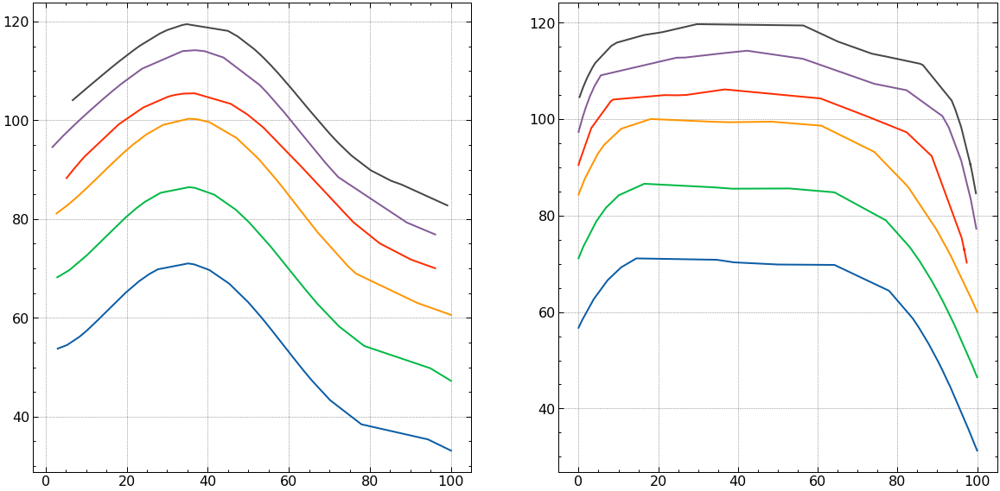

In [16]:
coefs_frame = pd.DataFrame()
fig = plt.figure(figsize=(20,10))
axes = fig.add_subplot(1,2,1)
axes2 = fig.add_subplot(1,2,2)
for p_ in p_list:
    p = HNO3_H2O[HNO3_H2O['p'] == p_]
    p = delete_experiment_rerrors(p, 'x')
    p = delete_experiment_rerrors(p, 'y')
    p_x = get_coeffs(p['x'], p['t'])
    p_y = get_coeffs(p['y'], p['t'])
    t_x = get_fit(p['x'],p['t'])
    t_y = get_fit(p['y'],p['t'])
    axes.plot(p['x'],t_x)
    axes2.plot(p['y'],t_y)
#     n = np.arange(100)
#     for i in range(100):
#         n[i] = np.poly1d(p_y)(i)- np.poly1d(p_x)(i)
#     ser = pd.Series(n)
    
#     coefs_frame[p_] = ser
# a = coefs_frame[(coefs_frame >= -1) & (coefs_frame <= 1)]
# a[350].dropna()

In [17]:
HCl_H2O = pd.read_excel('l_v\HCl-H2O.xlsx')
HCl_H2O['p'].value_counts()

-        24
760      13
743      10
751.3     8
751       8
         ..
83.6      1
84.1      1
14.4      1
10.2      1
89.5      1
Name: p, Length: 61, dtype: int64

In [18]:
HCl_H2O = delete_hyphens(HCl_H2O)
HCl_H2O = HCl_H2O.dropna()
HCl_H2O['p'].value_counts()

760.00    13
751.30     8
751.00     8
16.10      4
17.50      2
226.60     2
264.30     2
236.00     2
205.30     2
203.60     2
202.00     2
209.90     2
427.70     2
16.00      2
110.50     2
522.20     2
561.30     2
104.70     2
13.21      2
145.80     2
299.20     2
111.00     2
38.50      2
12.30      2
86.50      2
12.20      2
14.60      2
10.30      2
9.30       2
9.20       2
11.60      2
145.30     2
114.70     2
89.90      2
74.10      2
74.00      2
76.30      2
22.08      1
15.44      1
13.81      1
13.35      1
19.47      1
13.74      1
14.66      1
15.73      1
17.83      1
20.50      1
89.50      1
23.31      1
202.20     1
141.30     1
83.60      1
84.10      1
55.20      1
9.10       1
10.20      1
14.40      1
83.90      1
26.90      1
Name: p, dtype: int64

Text(0.5, 0, 'Количество соляной кислоты, %')

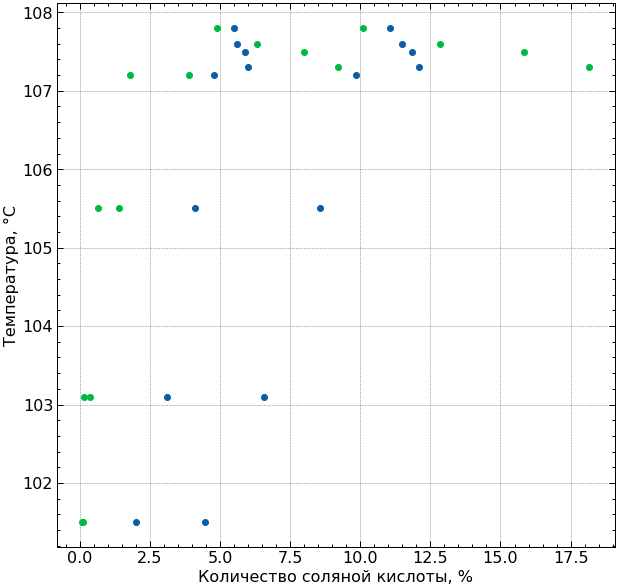

In [19]:
pHCl = HCl_H2O[(HCl_H2O['p'] == 751.0) | (HCl_H2O['p'] == 751.3)]
fig = plt.figure(figsize=(10,10))
axes = fig.add_subplot()
axes.scatter(pHCl['x'], pHCl['t'])
axes.scatter(pHCl['y'], pHCl['t'])
axes.set_ylabel('Температура, °С')
axes.set_xlabel('Количество соляной кислоты, %')

Text(0.5, 0, 'Количество соляной кислоты, %')

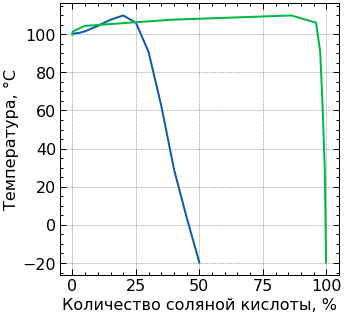

In [20]:
pHCl = HCl_H2O[HCl_H2O['p'] == 760.0]
fig = plt.figure(figsize=(5,5))
axes = fig.add_subplot()
axes.plot(pHCl['x'], pHCl['t'])
axes.plot(pHCl['y'], pHCl['t'])
axes.set_ylabel('Температура, °С')
axes.set_xlabel('Количество соляной кислоты, %')

In [21]:
HCl_H2O['t'].value_counts()

 19.95     29
 55.20     26
 75.90     23
 25.00     14
 107.60     3
 103.10     2
 107.20     2
 107.80     2
 107.50     2
 107.30     2
 101.50     2
 105.50     2
 90.70      1
-19.75      1
 3.85       1
 29.20      1
 62.50      1
 101.55     1
 106.04     1
 109.84     1
 104.35     1
 100.79     1
 100.00     1
 100.40     1
Name: t, dtype: int64

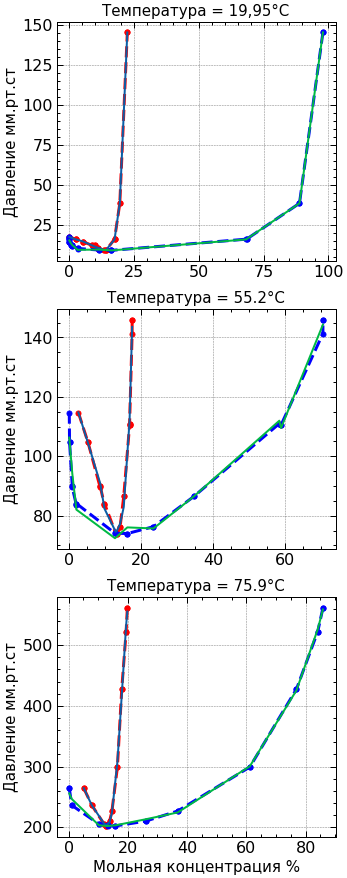

In [22]:
fig, axes = plt.subplots(nrows=3, ncols=1, figsize=(5,15))

#Строим график 19,95 градусов
tHCl = HCl_H2O[HCl_H2O['t'] == 19.95]
tHCl = tHCl.sort_values('x')
axes[0].plot(tHCl['x'], tHCl['p'], 'o--', color='red', lw=3, ms=5)
tHCl = tHCl.sort_values('y')
axes[0].plot(tHCl['y'], tHCl['p'], 'o--', color='blue', lw=3, ms=5)
axes[0].set_ylabel('Давление мм.рт.ст', fontsize=15)
#axes[0].set_xlabel('Мольная концентрация %', fontsize=15)
axes[0].set_title(r'Температура = 19,95°С', fontsize=15)

p_x = get_fit(tHCl['x'], tHCl['p'])
p_y = get_fit(tHCl['y'], tHCl['p'])
axes[0].plot(tHCl['x'], p_x)
axes[0].plot(tHCl['y'], p_y)


#Строим график 55.2 градусов
tHCl = HCl_H2O[HCl_H2O['t'] == 55.2]
tHCl = tHCl.sort_values(['x','p'])
tHCl = tHCl.drop([88,13])
axes[1].plot(tHCl['x'], tHCl['p'], 'o--', color='red', lw=3, ms=5)
tHCl = tHCl.sort_values('y')
axes[1].plot(tHCl['y'], tHCl['p'], 'o--', color='blue', lw=3, ms=5)
axes[1].set_ylabel('Давление мм.рт.ст', fontsize=15)
#axes[1].set_xlabel('Мольная концентрация %', fontsize=15)
axes[1].set_title(r'Температура = 55.2°С', fontsize=15)

p_x = get_fit(tHCl['x'], tHCl['p'])
p_y = get_fit(tHCl['y'], tHCl['p'])
axes[1].plot(tHCl['x'], p_x)
axes[1].plot(tHCl['y'], p_y)


#Строим график 75.9 градусов
tHCl = HCl_H2O[HCl_H2O['t'] == 75.9]
tHCl = tHCl.sort_values('x')
axes[2].plot(tHCl['x'], tHCl['p'], 'o--', color='red', lw=3, ms=5)
tHCl = tHCl.sort_values('y')
axes[2].plot(tHCl['y'], tHCl['p'], 'o--', color='blue', lw=3, ms=5)
axes[2].set_ylabel('Давление мм.рт.ст', fontsize=15)
axes[2].set_xlabel('Мольная концентрация %', fontsize=15)
axes[2].set_title(r'Температура = 75.9°С', fontsize=15)

p_x = get_fit(tHCl['x'], tHCl['p'])
p_y = get_fit(tHCl['y'], tHCl['p'])
axes[2].plot(tHCl['x'], p_x)
axes[2].plot(tHCl['y'], p_y)

plt.show()

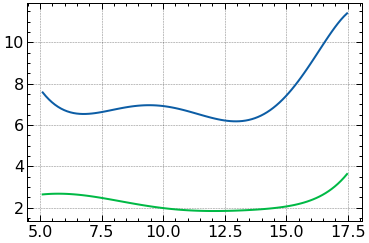

In [23]:
HCl=pd.DataFrame()
t1HCl = HCl_H2O[HCl_H2O['t'] == 19.95]
t2HCl = HCl_H2O[HCl_H2O['t'] == 55.2]
t3HCl = HCl_H2O[HCl_H2O['t'] == 75.9]
f1_x = get_coeffs(t1HCl['x'],t1HCl['p'])
f2_x = get_coeffs(t2HCl['x'],t2HCl['p'])
f3_x = get_coeffs(t3HCl['x'],t3HCl['p'])
t2HCl['x'].max() #Ищем область где все функции определены
t3HCl['x'].min()
concentration = np.linspace(t3HCl['x'].min(),t2HCl['x'].max(),100)
HCl['19'] = np.poly1d(f1_x)(concentration)
HCl['55'] = np.poly1d(f2_x)(concentration)
HCl['75']= np.poly1d(f3_x)(concentration)
tg1 = (HCl['55']-HCl['19'])/(55.2-19.95)
tg2 = (HCl['75']-HCl['55'])/(75.9-55.2)
temperature = np.linspace(19.95,55.2,100)
fk_1 = get_coeffs(concentration,tg1)
x, y = np.meshgrid(concentration,temperature)
z = np.poly1d(fk_1)(x)*(y-y[0])+np.poly1d(f1_x)(concentration)
plt.plot(concentration,tg2)
plt.plot(concentration,tg1)




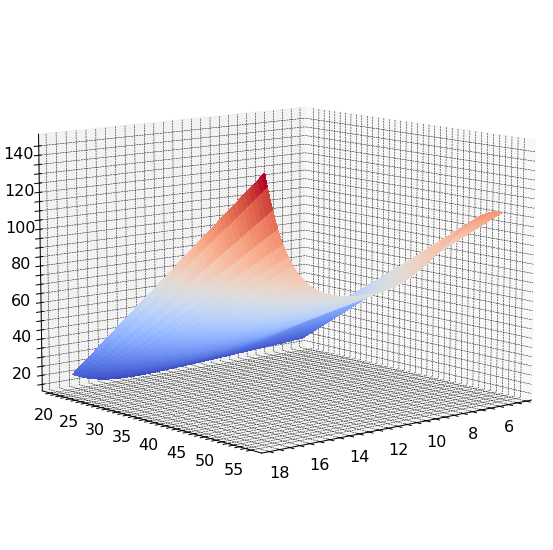

In [24]:
fig, ax = plt.subplots(subplot_kw={"projection": "3d"},figsize=(10,10))
ax.plot_surface(x,y,z, cmap='coolwarm',
                       linewidth=0, antialiased=False)
ax.view_init(elev=10, azim=50)

In [25]:
#https://plotly.com/python/3d-surface-plots/
HNO3x = pd.DataFrame()
HNO3y = pd.DataFrame()
f_x = pd.DataFrame()
f_y = pd.DataFrame()
surface_x_x = pd.DataFrame()
surface_y_x = pd.DataFrame()
surface_z_x = pd.DataFrame()
surface_x_y = pd.DataFrame()
surface_y_y = pd.DataFrame()
surface_z_y = pd.DataFrame()

for p_ in p_list:
    x = np.linspace(0,100,100) 
    p = HNO3_H2O[HNO3_H2O['p'] == p_]
    f_x[p_] = get_coeffs(p['x'],p['t'])
    f_y[p_] = get_coeffs(p['y'],p['t'])
    HNO3x[p_] = np.poly1d(f_x[p_])(x)
    HNO3y[p_] = np.poly1d(f_y[p_])(x)


def get_surface_data(data, low, high, f):
    x = np.linspace(0,100,100) 
    tg = (data[high] - data[low])/(high - low)
    y = np.linspace(low,high,100)
    fk = get_coeffs(x,tg)
    x_, y_ = np.meshgrid(x,y)
    z = np.poly1d(fk)(x_)*(y_-y_[0])+np.poly1d(f[low])(x)
    
    return x_,y_,z


p_list = list(HNO3_H2O['p'].value_counts().index)
p_list.sort()
for p_ in p_list:
    if len(p_list)== 1:
        break
    else:
        low = p_list[0]
        high = p_list[1]
        p_list = p_list[1::]
        _x, _y, _z = get_surface_data(data=HNO3x, low=low, high= high, f = f_x)
        surface_x_x = pd.concat([surface_x_x, pd.DataFrame(_x)])
        surface_y_x = pd.concat([surface_y_x, pd.DataFrame(_y)])
        surface_z_x = pd.concat([surface_z_x, pd.DataFrame(_z)])
    
p_list = list(HNO3_H2O['p'].value_counts().index)
p_list.sort()
for p_ in p_list:
    if len(p_list)== 1:
        break
    else:
        low = p_list[0]
        high = p_list[1]
        p_list = p_list[1::]
        _x, _y, _z = get_surface_data(data=HNO3y, low=low, high= high, f = f_y)
        surface_x_y = pd.concat([surface_x_y, pd.DataFrame(_x)])
        surface_y_y = pd.concat([surface_y_y, pd.DataFrame(_y)])
        surface_z_y = pd.concat([surface_z_y, pd.DataFrame(_z)])


In [26]:
fig = go.Figure(data=[go.Surface(z=surface_z_x, x=surface_x_x, y=surface_y_x),
                      go.Surface(z=surface_z_y, x=surface_x_y, y=surface_y_y, opacity=0.9)])    
fig.show()


In [27]:

def prepare_data(data: pd.DataFrame, filter_by: str, function_of: str, var_list: list, x_min = 0, x_max = 100, x_range = 100) -> pd.DataFrame:
    """Функция возвращает две таблицы. В первой исходные данные преобразуются так что: \n
    кривые экспериментов апроксиммируются и аргумент принимает значения от x_min до x_max, в колличестве x_range\n
    значения функции находятся для всего диапазона значений аргумента в каждой точке var_list  от function_of. 
    Вторая таблица хранит в себе коэффициенты функций кривых.
    

    Args:
        data (pd.DataFrame): Исходная таблица с экспериментами бинарного раствора.
        filter_by (str): 't' либо 'p' - переменная по оси Z.
        function_of (str): 't' либо 'p' - переменная, по оси Y. 
        var_list (list): ОТСОРТИРОВАННЫЙ список значений переменной по оси Z, в которых она определена.
        x_min (int, optional): Минимальный мольный процент интервала интерполяции. Defaults to 0.
        x_max (int, optional): Максимальный мольный процент интервала интерполяции. Defaults to 100.
        x_range (int, optional): Колличество шагов. Defaults to 100.

    Returns:
        pd.DataFrame: таблица с интерполированными данными
        pd.DataFrame: таблица с функциями кривых 
    """

    df = pd.DataFrame()
    f_= pd.DataFrame()
    for t in var_list:
        x = np.linspace(x_min,x_max,x_range) 
        t_ = data[data[filter_by] == t]
        t_ = t_.sort_values('x')
        t_ = delete_experiment_rerrors(t_, 'x')
        f_x = get_coeffs(t_['x'],t_[function_of])
        t_ = t_.sort_values('y')
        t_ = delete_experiment_rerrors(t_, 'y')
        f_y = get_coeffs(t_['y'],t_[function_of])
        df['x',t] = np.poly1d(f_x)(x)
        df['y',t] = np.poly1d(f_y)(x)
        f_['x',t] = f_x
        f_['y',t] = f_y
    return df, f_


def get_surface_data(data, low, high, f, dx, x_min = 0, x_max= 100, x_range = 100) -> pd.DataFrame:
    """Функция соединяет прямыми точки с одинаковым индексом от 'low' к 'high. В каждой точке 'x_range' находится производная; \n
    в случае линейной функции- тангенс 'tg' угла наклона прямой. Функция 'fk' показывает как меняется \n
    коэфициент k в уравнении прямой (y = kx+b) от 'х'. Занчение координаты 'z' в точке 'y' находится \n
    из уравнения прямой где k= fk(x), x = (y - y0), b= f(x)

    Args:
        data (_type_): Таблица с подготовленными данными после prepare_data
        low (_type_): Нижнее значение интерполируемой области
        high (_type_): Верхнее значение интерполируемой области
        f (_type_): Коэфициенты полинома функции кривой нижнего значения области. Берется из prepare_data
        dx (_type_): Длина прилежащего катета. 
        x_min (int, optional): Минимальный мольный процент интервала интерполяции. Defaults to 0.
        x_max (int, optional): Максимальный мольный процент интервала интерполяции. Defaults to 100.
        x_range (int, optional): Колличество шагов. Defaults to 100.

    Returns:
        pd.DataFrame: _description_
    """
    x = np.linspace(x_min,x_max,x_range) 
    tg = (data[high] - data[low])/(dx)
    y = np.linspace(list(low)[1],list(high)[1],100)
    fk = get_coeffs(x,tg)
    x_, y_ = np.meshgrid(x,y)
    z = np.poly1d(fk)(x_)*(y_-y_[0])+np.poly1d(f)(x)
    
    return x_,y_,z

    
def get_surface(prepared_data: pd.DataFrame, data_coefs: pd.DataFrame) -> pd.DataFrame:
    """Функция возвращает коодинаты двух поверхностей- значения жидкой и паровой фазы из \n 
    преобразоанной таблицы с исходными экспериментами функцией prepare_data.

    Args:
        prepared_data (pd.DataFrame): Таблица с преобразованными данными функцией prepare_data
        data_coefs (pd.DataFrame): коэфициенты функций кривых, полученных функцией prepare_data

    Returns:
        pd.DataFrame: четыре таблицы с координатами поверхностей
    """
    surface_x = pd.DataFrame()
    surface_y = pd.DataFrame()
    surface_zx = pd.DataFrame()
    surface_zy = pd.DataFrame()
    liquid_list = list(prepared_data.columns)[::2]
    vapor_list = list(prepared_data.columns)[1::2]
    for var in liquid_list:
        if len(liquid_list) == 1:
            break
        else:
            low_liquid = liquid_list[0]
            low_vapor = vapor_list[0]
            high_liquid = liquid_list[1]
            high_vapor = vapor_list[1]
            
            _x, _y, _zx = get_surface_data(
                data=prepared_data, low=low_liquid, high= high_liquid, 
                dx= (liquid_list[1][1] - liquid_list[0][1]), 
                f = data_coefs[low_liquid])
            
            _x, _y, _zy = get_surface_data(
                data=prepared_data, low=low_vapor, high= high_vapor,
                dx= (vapor_list[1][1] - vapor_list[0][1]),
                f = data_coefs[low_vapor])
            
            liquid_list = liquid_list[1::]
            vapor_list = vapor_list[1::]
            surface_x = pd.concat([surface_x, pd.DataFrame(_x)])
            surface_y = pd.concat([surface_y, pd.DataFrame(_y)])
            surface_zx = pd.concat([surface_zx, pd.DataFrame(_zx)])
            surface_zy = pd.concat([surface_zy, pd.DataFrame(_zy)])
            
    return surface_x, surface_y, surface_zx, surface_zy

In [28]:
p_list = list(HNO3_H2O['p'].value_counts().index)
p_list.sort()
test, func = prepare_data(data=HNO3_H2O, filter_by='p', function_of= 't', var_list = p_list)
_x, _y, _zx, _zy = get_surface(test, func)


In [29]:
fig = go.Figure(data=[go.Surface(z=_zx, x=_x, y=_y),
                      go.Surface(z=_zy, x=_x, y=_y, opacity=0.9)])    
fig.show()

In [30]:
HCl_mask = HCl_H2O['t'].value_counts().head(3).index
HCl_H2O[HCl_H2O['t'] == HCl_mask[0]]


,x,y,t,p
0,0.00,0.00,19.95,17.5
1,2.53,0.00,19.95,16.0
2,5.20,0.00,19.95,14.6
3,8.60,0.57,19.95,12.3
4,9.78,1.08,19.95,12.2
5,9.78,0.96,19.95,11.6
6,11.16,3.21,19.95,10.3
7,13.56,11.45,19.95,9.3
8,14.13,16.17,19.95,9.2
9,17.47,68.45,19.95,16.1


In [31]:
HCl_test, HCl_func = prepare_data(data=HCl_H2O, filter_by='t', function_of= 'p', var_list = HCl_mask)
_x, _y, _zx, _zy = get_surface(HCl_test, HCl_func)

In [32]:
fig = go.Figure(data=[go.Surface(z=_zx[range(22)], x=_x[range(22)], y=_y[range(22)]),
                    go.Surface(z=_zy[range(82)], x=_x[range(82)], y=_y[range(82)], opacity=0.9)])    
fig.show()

In [33]:
_zy

,0,1,2,3,4,5,6,7,8,9,...,90,91,92,93,94,95,96,97,98,99
0,15.319744,12.719983,10.861182,9.609737,8.845440,8.460731,8.359987,8.458816,8.683375,8.969707,...,50.059758,57.786683,67.144628,78.362732,91.689116,107.391761,125.759407,147.102468,171.753964,200.070474
1,16.158782,13.500057,11.595553,10.309415,9.519473,9.116482,9.003376,9.094550,9.315152,9.600401,...,76.865826,88.154853,101.447361,117.001052,135.094139,156.026278,180.119521,207.719277,239.195309,274.942733
2,16.997819,14.280131,12.329924,11.009093,10.193507,9.772233,9.646766,9.730284,9.946929,10.231094,...,103.671895,118.523024,135.750095,155.639372,178.499162,204.660796,234.479635,268.336087,306.636654,349.814991
3,17.836856,15.060204,13.064296,11.708770,10.867541,10.427984,10.290155,10.366019,10.578706,10.861788,...,130.477963,148.891194,170.052829,194.277692,221.904185,253.295314,288.839748,328.952897,374.078000,424.687250
4,18.675893,15.840278,13.798667,12.408448,11.541575,11.083736,10.933545,11.001753,11.210483,11.492482,...,157.284031,179.259365,204.355562,232.916012,265.309208,301.929832,343.199862,389.569706,441.519345,499.559509
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,251.980637,240.719416,231.210680,223.259844,216.687813,211.330211,207.036619,203.669840,201.105175,199.229725,...,762.587330,806.404483,854.183435,906.263110,963.004742,1024.792826,1092.036082,1165.168444,1244.650062,1330.968330
96,253.597439,242.306491,232.764856,224.779655,218.173213,212.782317,208.457472,205.062190,202.472289,200.575213,...,742.152876,782.637840,826.720995,874.712654,926.943883,983.767393,1045.558455,1112.715831,1185.662724,1264.847743
97,255.214241,243.893566,234.319033,226.299465,219.658614,214.234423,209.878326,206.454541,203.839404,201.920700,...,721.718421,758.871198,799.258555,843.162198,890.883023,942.741959,999.080828,1060.263219,1126.675386,1198.727156
98,256.831044,245.480641,235.873209,227.819276,221.144014,215.686530,211.299179,207.846892,205.206518,203.266188,...,701.283967,735.104555,771.796115,811.611742,854.822164,901.716526,952.603200,1007.810607,1067.688048,1132.606569


In [34]:
NH3_H2O = pd.read_excel('l_v\\NH3-H2O.xlsx')
NH3_H2O

,x,y,t,p
0,2.1,23.2,91.5,1.0
1,4.1,42.1,84.8,1.0
2,6.1,55.5,79.0,1.0
3,8.2,67,73.5,1.0
4,10.2,73.9,68.4,1.0
...,...,...,...,...
198,53.6,-,60.0,10.0
199,61.3,-,50.0,10.0
200,71.4,-,40.0,10.0
201,87.6,-,30.0,10.0


In [35]:
z_data = NH3_H2O.pivot_table(
    values='t',
    index='x',
    columns='p',
    fill_value= 0
)
fig = go.Figure(data=[go.Surface(z=z_data.values)])
fig.update_layout(title='', autosize=False,
                  width=500, height = 500,
                  margin=dict(l = 65, r = 50, b = 65, t = 90))

fig.show()

In [36]:
NH3_H2O['t'].value_counts().head(10)




80.0     14
100.0    13
90.0     13
120.0    12
60.0     12
110.0    12
130.0    11
140.0    10
40.0      8
150.0     8
Name: t, dtype: int64

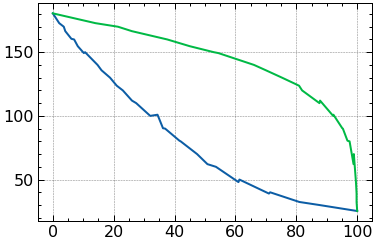

In [37]:
NH3_H2O = delete_hyphens(NH3_H2O)
NH3 =  NH3_H2O[NH3_H2O['p'] == 10]
NH3 = NH3.sort_values('x')
plt.plot(NH3['x'],NH3['t'])
NH3 = NH3.sort_values('y')
plt.plot(NH3['y'],NH3['t'])


In [38]:
NH3_H2O['y'].value_counts()

0.0      17
100.0     8
95.1      3
93.6      2
97.6      2
         ..
88.5      1
83.6      1
76.3      1
65.8      1
98.9      1
Name: y, Length: 127, dtype: int64

In [39]:
z_data = NH3_H2O.pivot_table(
    values='t',
    index='x',
    columns='p',
    fill_value= np.nan
)


In [40]:
def columns_poly(data, min):
    
    df = pd.DataFrame()
    mask = data.count(axis=0).sort_values() > min
    mask = mask[mask == True].index
    for p in mask:
        data[p].dropna()
        y = get_coeffs(data[p].dropna().index, data[p].dropna().values)
        df[p] = np.poly1d(y)(data.index)
    df.index = data.index
    return df

def rows_poly(data, min):
        
    df = pd.DataFrame()
    mask = data.count(axis=1).sort_values() > min
    mask = mask[mask == True].index
    for x in mask:
        data.loc[x].dropna()
        y = get_coeffs(data.loc[x].dropna().index, data.loc[x].dropna().values)
        df[x] = np.poly1d(y)(data.columns)
    df.index = data.columns
    return df

In [41]:
df = columns_poly(z_data, 10)
df2 = rows_poly(z_data, 5)
df2 = df2.T
b = df.loc[df2.index]
a = df2[df.columns]
c = (b + a)/2 
z_data = z_data.fillna(c)
c


C:\Users\davjd\AppData\Local\Temp\ipykernel_3860\265291553.py:20: RankWarning:

Polyfit may be poorly conditioned

C:\Users\davjd\AppData\Local\Temp\ipykernel_3860\265291553.py:20: RankWarning:

Polyfit may be poorly conditioned



,0.5,6.0,2.0,4.0,8.0,1.0,10.0
31.2,-13.368665,83.215500,32.869801,65.503186,93.642727,5.855715,102.167006
26.1,41.013044,93.214591,60.959154,78.834261,104.225183,49.478151,113.377719
100.0,-46.674051,9.689359,-18.611303,-1.471010,18.518864,-32.890873,25.282573
5.3,63.296508,143.894169,103.325033,127.693709,125.943300,82.382514,-447.427679
20.9,27.749887,104.037908,67.333970,89.580875,116.094359,45.617096,125.330516
15.7,38.963640,116.871510,78.469384,100.683871,127.780613,57.486838,136.120966
10.5,49.753622,128.853561,89.876609,113.899530,141.069773,69.098579,149.907016
0.0,80.936610,158.899335,120.617685,143.991477,170.978869,100.381459,180.561648


In [42]:
z_data.isnull().sum().sum()



6348

In [43]:
z_data = z_data.fillna(df)
z_data

p,0.197,0.200,0.439,0.467,0.500,0.692,0.717,0.900,1.000,1.084,...,11.330,11.720,11.980,13.580,14.370,15.040,15.460,18.600,19.200,19.800
x,,,,,,,,,,,,,,,,,,,,,
0.00,60.0,60.4,NaN,80.0,81.700000,90.0,NaN,NaN,100.000000,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0.15,NaN,NaN,NaN,NaN,80.856483,NaN,NaN,NaN,99.218383,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0.30,NaN,NaN,NaN,NaN,80.000000,NaN,NaN,NaN,98.639989,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1.00,NaN,NaN,NaN,NaN,77.467756,NaN,NaN,NaN,96.011479,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2.10,NaN,NaN,NaN,NaN,73.397422,NaN,NaN,NaN,91.500000,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
86.70,NaN,NaN,NaN,NaN,-45.506770,NaN,NaN,NaN,-30.000000,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
87.60,NaN,NaN,NaN,NaN,-45.907275,NaN,NaN,NaN,-30.339079,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
94.90,NaN,NaN,NaN,NaN,-47.839925,NaN,NaN,NaN,-32.444860,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
